# Data Processing

### 0. Download data

**Download the final dataframe from the webscrapping process**

- Due to the size of the database, it is necessary to access directly from the raw file of the csv located in `../main/stores/` you need to subtract the raw URL of the csv from the 'Raw' view of the `df_definitivo.csv` dataframe on GitHub, this will be necessary to run the script.

In [1]:
pip install ydata-profiling --quiet

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 356.2/356.2 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 17.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 35.9 MB/s eta 0:00:00


In [55]:
import pandas as pd
import numpy as np
from ydata_profiling import ProfileReport
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [5]:
# Replace the url with the url generated in Github (the token is different)
url = "https://raw.githubusercontent.com/dacero21/Problem_Set_1/main/stores/df_definitivo.csv?token=GHSAT0AAAAAACXNYI6VG3Y2GBACUMYQYTXIZXHOA4A"
dataset = pd.read_csv(url)
dataset

,Unnamed: 0,id,directorio,secuencia_p,orden,clase,dominio,mes,estrato1,sex,...,y_viaticos_m,y_accidentes_m,y_salarySec_m,y_ingLab_m_ha,y_gananciaNeta_m,y_gananciaNetaAgro_m,y_gananciaIndep_m,y_gananciaIndep_m_hu,y_total_m,y_total_m_ha
0,0,1,4514331,1,2,1,BOGOTA,1,2,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2,4514331,1,1,1,BOGOTA,1,2,1,...,NaN,NaN,NaN,8404.320312,NaN,NaN,NaN,NaN,1.620833e+06,8404.320312
2,2,3,4514332,1,4,1,BOGOTA,1,2,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,4,4514332,1,3,1,BOGOTA,1,2,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,5,4514332,1,1,1,BOGOTA,1,2,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32172,3212,3213,4804454,1,2,1,BOGOTA,12,2,0,...,NaN,NaN,NaN,3345.555664,NaN,NaN,NaN,NaN,1.003667e+06,3345.555664
32173,3213,3214,4804455,1,1,1,BOGOTA,12,3,0,...,500000.0,NaN,NaN,25958.333984,NaN,NaN,NaN,NaN,6.675000e+06,25958.333984
32174,3214,3215,4804455,1,2,1,BOGOTA,12,3,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
32175,3215,3216,4804455,1,3,1,BOGOTA,12,3,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 1. Data cleaning

In this case, it is necessary to define the scope of our data with the purpose defined in the problem. Since the main objective is to build an individual wage model, it will not be necessary to include variables related to housing, nor geographic data since the data is only from Bogota, nor identifiers since they have a high cardinality and little importance in a predictive model.

In [6]:
'''
Data cleaning process:

1. Adjust data according to statement 2 of only employed persons older than 18 years old.
Therefore age >= 18 and dsi = 0, where dsi = 0 means employed. Then drop dsi

2. Drop identifiers like 'Unnamed: 0', 'id', 'directorio', 'orden', 'secuencia_p'.

3. Drop geographic related variables like 'clase', 'depto', 'dominio',

'''

def cleaning_data(dataset):
    dataset = dataset[dataset['age'] >= 18]
    dataset = dataset[dataset['dsi'] == 0]
    dataset = dataset.drop(columns=['Unnamed: 0', 'id', 'directorio', 'orden', 'secuencia_p', 'dsi', 'dominio', 'clase', 'depto'])

    return dataset

In [7]:
dataset_v1 = cleaning_data(dataset)

In [8]:
dataset_v1

,mes,estrato1,sex,age,p6050,p6090,p6100,p6210,p6210s1,p6240,...,y_viaticos_m,y_accidentes_m,y_salarySec_m,y_ingLab_m_ha,y_gananciaNeta_m,y_gananciaNetaAgro_m,y_gananciaIndep_m,y_gananciaIndep_m_hu,y_total_m,y_total_m_ha
0,1,2,0,29,2,1.0,2.0,5.0,11.0,6.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2,1,36,1,1.0,2.0,5.0,11.0,1.0,...,NaN,NaN,NaN,8404.320312,NaN,NaN,NaN,NaN,1.620833e+06,8404.320312
4,1,2,0,32,1,1.0,1.0,4.0,7.0,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,1,2,1,18,3,1.0,1.0,6.0,2.0,3.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,1,2,1,51,1,1.0,1.0,6.0,3.0,1.0,...,NaN,NaN,NaN,6703.342773,NaN,NaN,NaN,NaN,1.378973e+06,6703.342773
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32167,12,3,1,23,4,1.0,1.0,6.0,2.0,6.0,...,NaN,NaN,NaN,NaN,200000.0,NaN,200000.0,9333.333008,2.000000e+05,9333.333008
32171,12,2,1,27,1,1.0,1.0,5.0,10.0,1.0,...,NaN,NaN,NaN,4453.359375,NaN,NaN,NaN,NaN,9.161197e+05,4453.359375
32172,12,2,0,24,2,1.0,1.0,5.0,11.0,1.0,...,NaN,NaN,NaN,3345.555664,NaN,NaN,NaN,NaN,1.003667e+06,3345.555664
32173,12,3,0,36,1,1.0,1.0,6.0,8.0,6.0,...,500000.0,NaN,NaN,25958.333984,NaN,NaN,NaN,NaN,6.675000e+06,25958.333984


### 2. Defining variables

In this process we must review the behavior of our data in terms of data quality. That is, our data must be complete, consistent and without redundancies. Therefore we will check both the proportion of nulls and the derived variables based on the data dictionary.

In [9]:
def defining_variables_nulls(X):
  df_selected = X
  # Calculate the proportion of null values for each column
  null_proportion = df_selected.isnull().sum() / len(df_selected)
  # Select columns with a proportion of nulls greater than 0.3 (30%)
  columns_to_drop = null_proportion[null_proportion > 0.3].index
  print(columns_to_drop)
  return columns_to_drop

In [36]:
columns_to_drop = defining_variables_nulls(dataset_v1)
columns_to_drop = list(columns_to_drop)
columns_to_drop.remove('y_salary_m_hu')
len(columns_to_drop)
# There are 111 columns with at least 30% missing data, these variables will add noise to the data set
# and we will not be able to reconstruct the missing cells since our data set is not large enough in
# terms of observations, since 30% equals approximately 6600 rows.

Index(['p6500', 'p6510', 'p6510s1', 'p6510s2', 'p6545', 'p6545s1', 'p6545s2',
       'p6580', 'p6580s1', 'p6580s2',
       ...
       'y_viaticos_m', 'y_accidentes_m', 'y_salarySec_m', 'y_ingLab_m_ha',
       'y_gananciaNeta_m', 'y_gananciaNetaAgro_m', 'y_gananciaIndep_m',
       'y_gananciaIndep_m_hu', 'y_total_m', 'y_total_m_ha'],
      dtype='object', length=113)


112

In [37]:
dataset_v2 = dataset_v1.drop(columns=columns_to_drop)
dataset_v2

,mes,estrato1,sex,age,p6050,p6090,p6100,p6210,p6210s1,p6240,...,ocu,pea,inac,totalHoursWorked,formal,informal,cuentaPropia,microEmpresa,sizeFirm,y_salary_m_hu
0,1,2,0,29,2,1.0000000000,2.0000000000,5.0000000000,11.0000000000,6.0000000000,...,0,0,1,NaN,NaN,NaN,0,NaN,NaN,NaN
1,1,2,1,36,1,1.0000000000,2.0000000000,5.0000000000,11.0000000000,1.0000000000,...,1,1,0,45.0000000000,1.0000000000,0.0000000000,0,0.0000000000,5.0000000000,6740.7407226562
4,1,2,0,32,1,1.0000000000,1.0000000000,4.0000000000,7.0000000000,4.0000000000,...,0,0,1,NaN,NaN,NaN,0,NaN,NaN,NaN
6,1,2,1,18,3,1.0000000000,1.0000000000,6.0000000000,2.0000000000,3.0000000000,...,0,0,1,NaN,NaN,NaN,0,NaN,NaN,NaN
8,1,2,1,51,1,1.0000000000,1.0000000000,6.0000000000,3.0000000000,1.0000000000,...,1,1,0,48.0000000000,1.0000000000,0.0000000000,0,0.0000000000,3.0000000000,5833.3334960938
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32167,12,3,1,23,4,1.0000000000,1.0000000000,6.0000000000,2.0000000000,6.0000000000,...,1,1,0,5.0000000000,0.0000000000,1.0000000000,1,1.0000000000,1.0000000000,NaN
32171,12,2,1,27,1,1.0000000000,1.0000000000,5.0000000000,10.0000000000,1.0000000000,...,1,1,0,48.0000000000,1.0000000000,0.0000000000,0,0.0000000000,5.0000000000,3797.7041015625
32172,12,2,0,24,2,1.0000000000,1.0000000000,5.0000000000,11.0000000000,1.0000000000,...,1,1,0,70.0000000000,1.0000000000,0.0000000000,0,0.0000000000,5.0000000000,3000.0000000000
32173,12,3,0,36,1,1.0000000000,1.0000000000,6.0000000000,8.0000000000,6.0000000000,...,1,1,0,60.0000000000,1.0000000000,0.0000000000,0,0.0000000000,5.0000000000,24500.0000000000


In [38]:
sorted(dataset_v2.columns.tolist())

['age',
 'college',
 'cotPension',
 'cuentaPropia',
 'estrato1',
 'fex_c',
 'fex_dpto',
 'formal',
 'fweight',
 'hoursWorkUsual',
 'impa',
 'inac',
 'informal',
 'ingtot',
 'ingtotob',
 'iof1',
 'iof2',
 'iof3h',
 'iof3i',
 'iof6',
 'isa',
 'maxEducLevel',
 'mes',
 'microEmpresa',
 'ocu',
 'oficio',
 'p6050',
 'p6090',
 'p6100',
 'p6210',
 'p6210s1',
 'p6240',
 'p6426',
 'p6870',
 'p6920',
 'p7040',
 'p7070',
 'p7090',
 'p7495',
 'p7500s1a1',
 'p7500s2a1',
 'p7500s3a1',
 'p7505',
 'p7510s1a1',
 'p7510s2a1',
 'p7510s3a1',
 'p7510s5a1',
 'p7510s6a1',
 'p7510s7a1',
 'pea',
 'pet',
 'regSalud',
 'relab',
 'sex',
 'sizeFirm',
 'totalHoursWorked',
 'wap',
 'y_salary_m_hu']

In [39]:
'''
Based on the data dictionary, we will check redundant columns that may generate a possible
collinearity between predictor variables, in order to reduce the dimensionality of the dataframe.
'''
def cleaning_data_dictionary(X):
  dataset = X.drop(columns=['fex_c', 'fex_dpto', 'impa', 'inac', 'ingtotob', 'iof1', 'iof2', 'iof3h',
                            'iof3i', 'iof6', 'p6050', 'p6100', 'p6210s1', 'p6240', 'p7070', 'p7090',
                            'p7500s1a1', 'p7500s2a1', 'p7500s3a1', 'p7505', 'p7510s1a1', 'p7510s2a1',
                            'p7510s3a1', 'p7510s5a1', 'p7510s6a1', 'p7510s7a1'])
  return dataset

In [40]:
dataset_v3 = cleaning_data_dictionary(dataset_v2)
dataset_v3

,mes,estrato1,sex,age,p6090,p6210,oficio,p6426,relab,hoursWorkUsual,...,wap,ocu,pea,totalHoursWorked,formal,informal,cuentaPropia,microEmpresa,sizeFirm,y_salary_m_hu
0,1,2,0,29,1.0000000000,5.0000000000,NaN,NaN,NaN,NaN,...,1,0,0,NaN,NaN,NaN,0,NaN,NaN,NaN
1,1,2,1,36,1.0000000000,5.0000000000,39.0000000000,166.0000000000,2.0000000000,45.0000000000,...,1,1,1,45.0000000000,1.0000000000,0.0000000000,0,0.0000000000,5.0000000000,6740.7407226562
4,1,2,0,32,1.0000000000,4.0000000000,NaN,NaN,NaN,NaN,...,1,0,0,NaN,NaN,NaN,0,NaN,NaN,NaN
6,1,2,1,18,1.0000000000,6.0000000000,NaN,NaN,NaN,NaN,...,1,0,0,NaN,NaN,NaN,0,NaN,NaN,NaN
8,1,2,1,51,1.0000000000,6.0000000000,85.0000000000,12.0000000000,1.0000000000,48.0000000000,...,1,1,1,48.0000000000,1.0000000000,0.0000000000,0,0.0000000000,3.0000000000,5833.3334960938
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32167,12,3,1,23,1.0000000000,6.0000000000,3.0000000000,4.0000000000,4.0000000000,5.0000000000,...,1,1,1,5.0000000000,0.0000000000,1.0000000000,1,1.0000000000,1.0000000000,NaN
32171,12,2,1,27,1.0000000000,5.0000000000,39.0000000000,6.0000000000,1.0000000000,48.0000000000,...,1,1,1,48.0000000000,1.0000000000,0.0000000000,0,0.0000000000,5.0000000000,3797.7041015625
32172,12,2,0,24,1.0000000000,5.0000000000,53.0000000000,18.0000000000,1.0000000000,70.0000000000,...,1,1,1,70.0000000000,1.0000000000,0.0000000000,0,0.0000000000,5.0000000000,3000.0000000000
32173,12,3,0,36,1.0000000000,6.0000000000,21.0000000000,48.0000000000,1.0000000000,60.0000000000,...,1,1,1,60.0000000000,1.0000000000,0.0000000000,0,0.0000000000,5.0000000000,24500.0000000000


### 3. Analysis of the final dataframe

In this process, we must review the significance of the set of variables with respect to our target variable. For this we will check the correlation between variables as well as the distribution of data.

In [41]:
ProfileReport(dataset_v3)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

According to the report there are several columns that are not necessary at the time of modeling, either because they belong to a single category or are unbalanced categories generating a bias within the model. Thus we drop some variables like `p6090, p7040, p7495, pet, isa, wap, ocu`. In addition, we see that the variable `estrato1, p6210, oficio, relab, maxEducLevel` are being taken as a real number when they are categorical, and also we drop 10 duplicate rows.

In [42]:
def cleaning_data_v3(X):
  dataset = X.drop(columns=['p6090', 'p7040', 'p7495', 'pet', 'isa', 'wap', 'ocu', 'cuentaPropia'])
  dataset[['estrato1', 'p6210', 'oficio', 'relab', 'maxEducLevel']] = dataset[['estrato1', 'p6210', 'oficio', 'relab', 'maxEducLevel']].astype('category')
  dataset = dataset.drop_duplicates()
  return dataset

In [43]:
dataset_v4 = cleaning_data_v3(dataset_v3)
dataset_v4

,mes,estrato1,sex,age,p6210,oficio,p6426,relab,hoursWorkUsual,p6870,...,college,regSalud,cotPension,pea,totalHoursWorked,formal,informal,microEmpresa,sizeFirm,y_salary_m_hu
0,1,2,0,29,5.0000000000,NaN,NaN,NaN,NaN,NaN,...,1,2.0000000000,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2,1,36,5.0000000000,39.0000000000,166.0000000000,2.0000000000,45.0000000000,9.0000000000,...,1,2.0000000000,1.0000000000,1,45.0000000000,1.0000000000,0.0000000000,0.0000000000,5.0000000000,6740.7407226562
4,1,2,0,32,4.0000000000,NaN,NaN,NaN,NaN,NaN,...,0,1.0000000000,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN
6,1,2,1,18,6.0000000000,NaN,NaN,NaN,NaN,NaN,...,0,1.0000000000,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN
8,1,2,1,51,6.0000000000,85.0000000000,12.0000000000,1.0000000000,48.0000000000,4.0000000000,...,0,1.0000000000,1.0000000000,1,48.0000000000,1.0000000000,0.0000000000,0.0000000000,3.0000000000,5833.3334960938
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32167,12,3,1,23,6.0000000000,3.0000000000,4.0000000000,4.0000000000,5.0000000000,1.0000000000,...,0,1.0000000000,2.0000000000,1,5.0000000000,0.0000000000,1.0000000000,1.0000000000,1.0000000000,NaN
32171,12,2,1,27,5.0000000000,39.0000000000,6.0000000000,1.0000000000,48.0000000000,9.0000000000,...,1,1.0000000000,1.0000000000,1,48.0000000000,1.0000000000,0.0000000000,0.0000000000,5.0000000000,3797.7041015625
32172,12,2,0,24,5.0000000000,53.0000000000,18.0000000000,1.0000000000,70.0000000000,9.0000000000,...,1,1.0000000000,1.0000000000,1,70.0000000000,1.0000000000,0.0000000000,0.0000000000,5.0000000000,3000.0000000000
32173,12,3,0,36,6.0000000000,21.0000000000,48.0000000000,1.0000000000,60.0000000000,9.0000000000,...,0,1.0000000000,1.0000000000,1,60.0000000000,1.0000000000,0.0000000000,0.0000000000,5.0000000000,24500.0000000000


In [44]:
dataset_v4.info()

<class 'pandas.core.frame.DataFrame'>
Index: 22620 entries, 0 to 32174
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   mes               22620 non-null  int64   
 1   estrato1          22620 non-null  category
 2   sex               22620 non-null  int64   
 3   age               22620 non-null  int64   
 4   p6210             22620 non-null  category
 5   oficio            16542 non-null  category
 6   p6426             16542 non-null  float64 
 7   relab             16542 non-null  category
 8   hoursWorkUsual    16542 non-null  float64 
 9   p6870             16542 non-null  float64 
 10  p6920             16542 non-null  float64 
 11  ingtot            22620 non-null  float64 
 12  fweight           22620 non-null  int64   
 13  maxEducLevel      22618 non-null  category
 14  college           22620 non-null  int64   
 15  regSalud          20854 non-null  float64 
 16  cotPension        16542 non

In [45]:
ProfileReport(dataset_v4)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

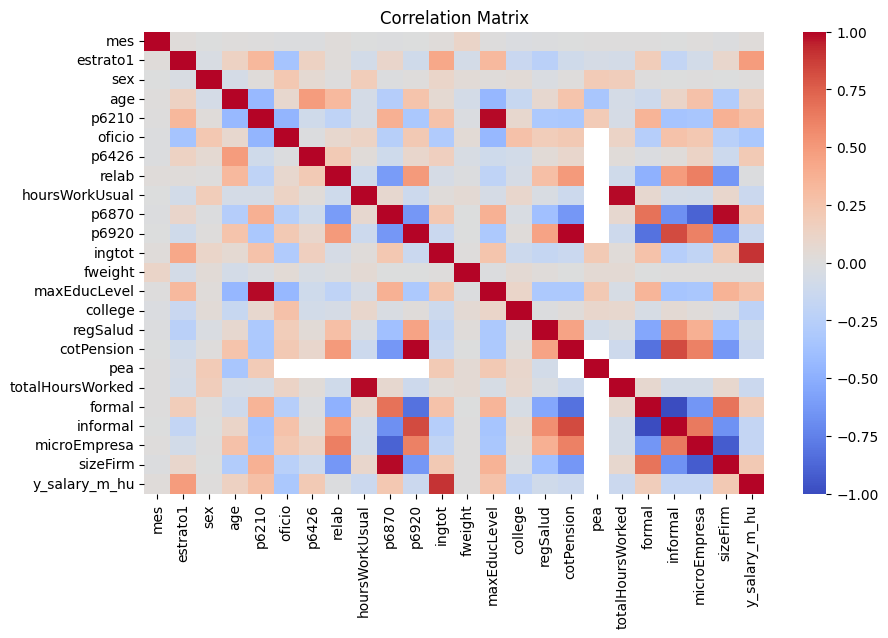

In [46]:
# Let's see the correlations between variables in this final dataframe

plt.figure(figsize=(10, 6))
sns.heatmap(dataset_v4.corr(), annot=False, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.show()

In [80]:
def analyze_collinearity(X, vif_threshold=10):
    # Temporal dataframe
    df_temp = X.dropna()

    # Calcular el VIF para cada columna
    X_temp = df_temp.copy()
    X_temp['intercepto'] = 1  # Añadir una columna de intercepto para el cálculo del VIF
    vif_data = pd.DataFrame()
    vif_data['Variable'] = X_temp.columns
    vif_data['VIF'] = [variance_inflation_factor(X_temp.values, i) for i in range(X_temp.shape[1])]

    # Filtrar columnas con VIF alto
    high_vif_columns = vif_data[vif_data['VIF'] > vif_threshold]['Variable'].tolist()
    print(high_vif_columns)

    df_high_vif = df_temp[high_vif_columns]

    # Calcular la matriz de correlación
    correlation_matrix = df_high_vif.corr()

    # Mostrar la matriz de correlación
    plt.figure(figsize=(10, 6))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
    plt.title('Correlation Matrix on High VIF (>10) variables')
    plt.savefig('correlation_matrix_high_vif.png', format='png', dpi=300, bbox_inches='tight')
    plt.show()



/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)
/usr/local/lib/python3.10/dist-packages/statsmodels/regression/linear_model.py:1783: RuntimeWarning: divide by zero encountered in scalar divide
  return 1 - self.ssr/self.centered_tss


['p6210', 'hoursWorkUsual', 'p6870', 'p6920', 'maxEducLevel', 'cotPension', 'totalHoursWorked', 'formal', 'informal', 'sizeFirm']


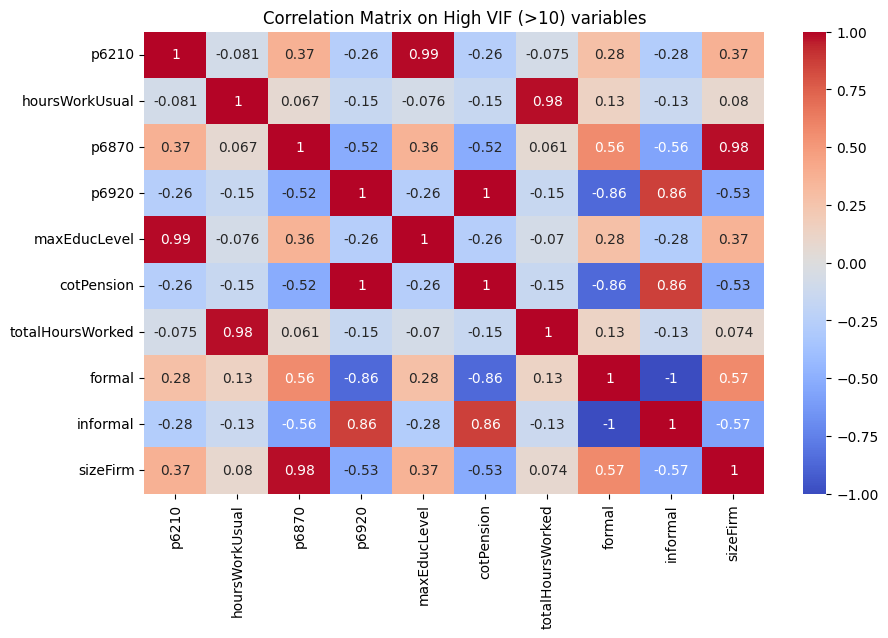

In [81]:
analyze_collinearity(dataset_v4)

In [49]:
# Now let's check the cardinality of the category columns
def plot_categorical_histograms(df):
    # Filtrar las variables categóricas
    categorical_columns = df.select_dtypes(include=['object', 'category']).columns

    # Graficar histogramas para cada variable categórica
    for column in categorical_columns:
        plt.figure(figsize=(10, 5))
        sns.countplot(x=column, data=df)
        plt.title(f'Frecuencia de {column}')
        plt.xticks(rotation=45)  # Rotar las etiquetas del eje x si es necesario
        plt.show()


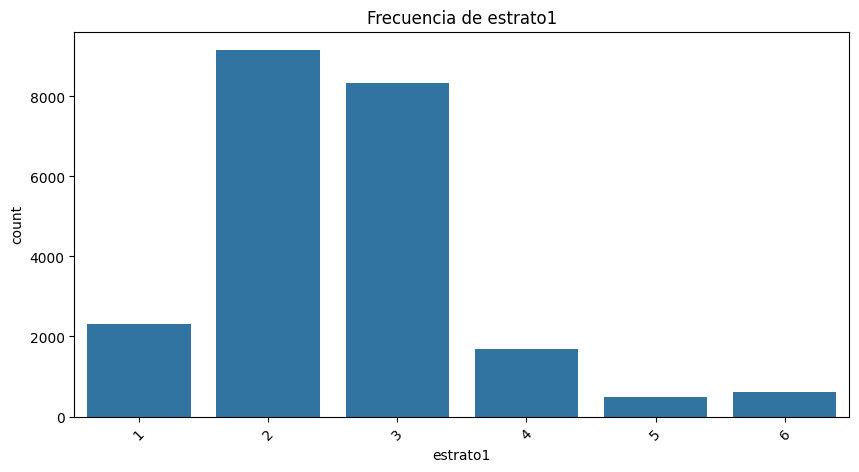

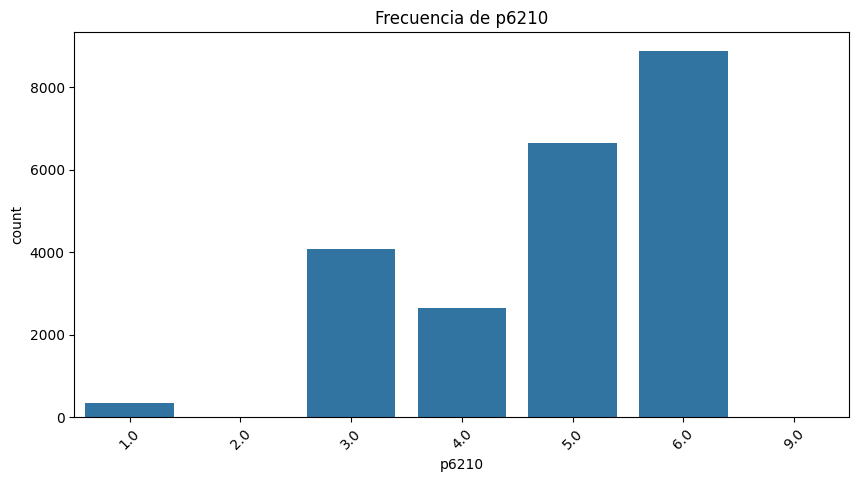

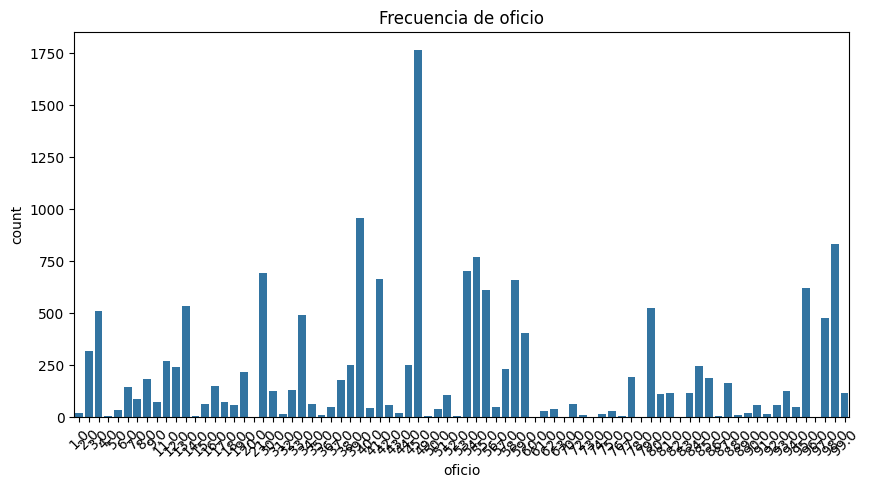

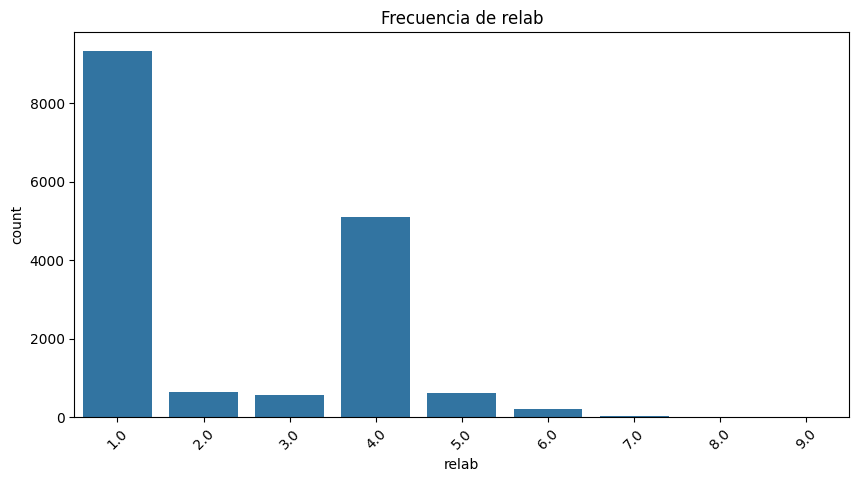

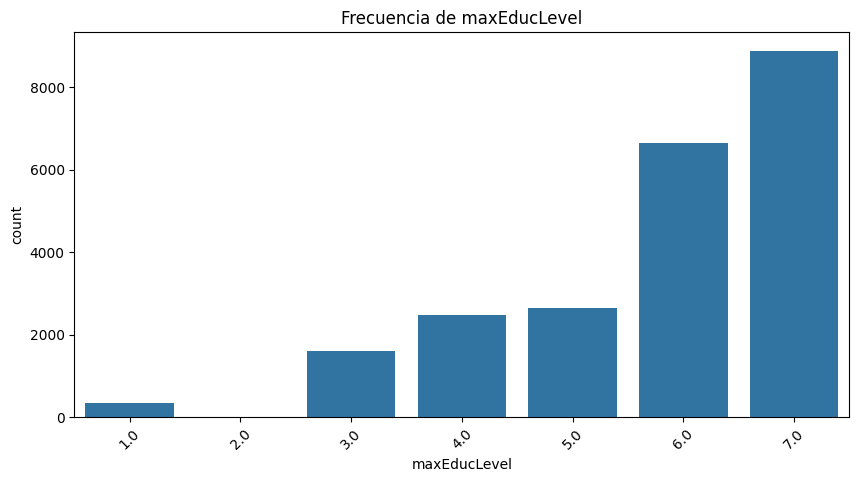

In [50]:
plot_categorical_histograms(dataset_v4)

In [67]:
def analyze_target_variable(df, Y):
  desc_stats = df[Y].describe()
  print('Descriptive Statistics')
  print(desc_stats)

  pd.set_option('display.float_format', '{:.10f}'.format)
  # Density plot
  plt.figure(figsize=(12, 6))
  sns.histplot(df[Y], bins=int(np.sqrt(len(df))), kde=True)
  plt.xlim(0, df[Y].quantile(0.95))
  sns.kdeplot(df[Y], fill=True, color='orange')
  plt.title(f'Density plot of {Y}')
  plt.xlabel(Y)
  plt.ylabel('Densidad')
  plt.show()

  # Boxplot
  plt.figure(figsize=(12, 6))
  sns.boxplot(x=df[Y], color='lightgreen')
  plt.xlim(0, df[Y].quantile(0.95))
  plt.title(f'Boxplot of {Y}')
  plt.xlabel(Y)
  plt.show()


Descriptive Statistics
count     9892.0000000000
mean      7945.6429916903
std      11607.1519440540
min        151.9097290039
25%       3797.7041015625
50%       4475.9846191406
75%       7291.6665039062
max     291666.6562500000
Name: y_salary_m_hu, dtype: float64


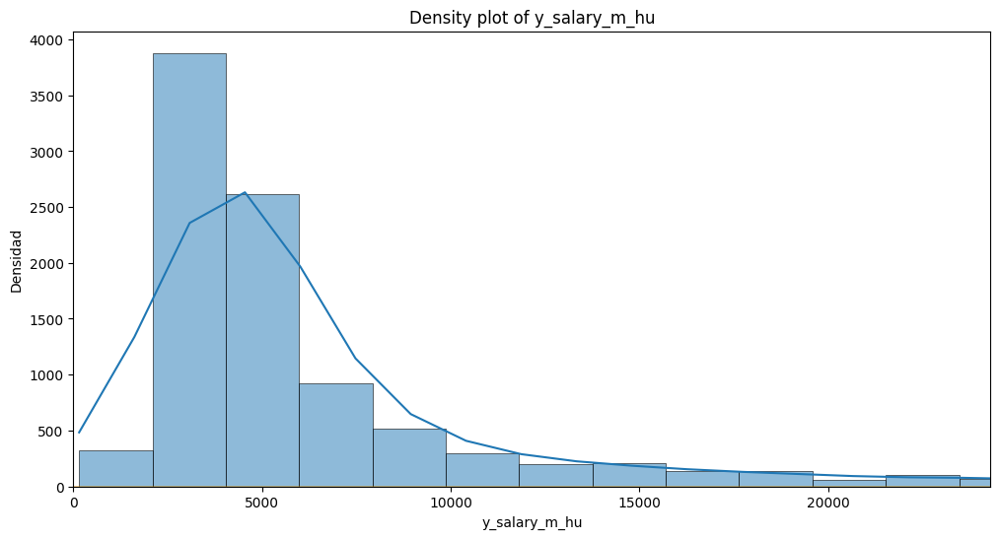

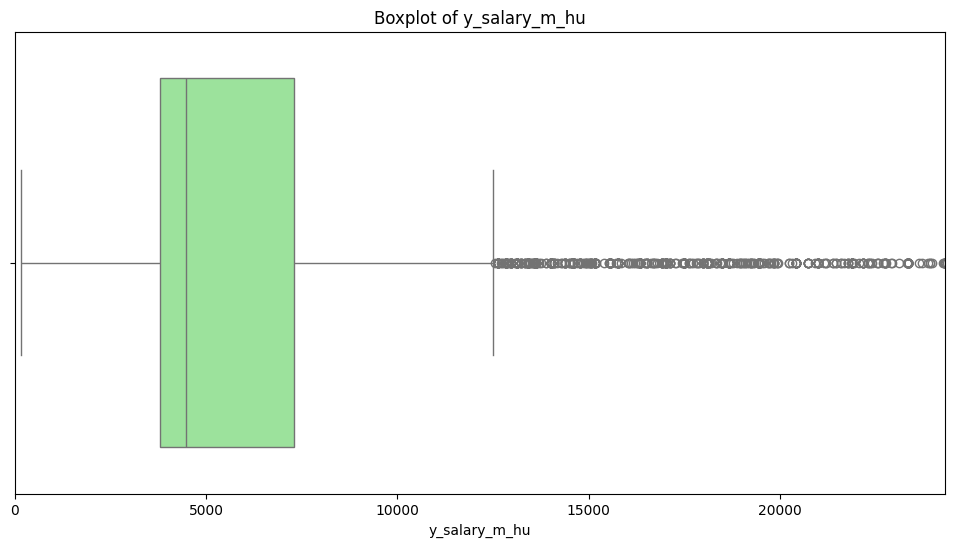

In [68]:
analyze_target_variable(dataset_v4, 'y_salary_m_hu')

In [64]:
'''
The variable p6920 and formal are reductive because if you are working formally then you will be quoting -> Drop 6920.
The informal and formal variables are perfectly correlated, therefore the informal variable can be dropped.
The variable p6870 is redundant together with sizeFirm, therefore p6870 is dropped.
The variable p6210 and maxEducLevel are redundant, so p6210 is dropped.
The variables totalHoursWorked and hoursWorkUsual are redundant, so drop totalHoursWorked.
The variable cotPension and formal are redundant because if you work formally then you will be contributing -> Drop cotPension
The oficio variable has a high cardinality, therefore it is not recommended to be used due to the number of categories, so
relab is used being a column related to the type of work and with a better grouping of the data.

Looking at our target variable 'y_salary_m_hu' which has a positive skewness, it is necessary to consider replacing the 0's by the
median. Since the average may be biased by the number of extreme values.
'''


def final_cleaning(X):
  dataset = X.drop(columns=['p6920', 'informal', 'p6870', 'p6210', 'totalHoursWorked', 'cotPension', 'oficio', 'ingtot'])
  dataset = dataset.dropna(subset=['y_salary_m_hu'])
  dataset['y_salary_m_hu'] = dataset['y_salary_m_hu'].replace(0, dataset['y_salary_m_hu'].median())
  dataset['y_salary_m_hu'] = dataset['y_salary_m_hu'].astype(int)
  dataset[['mes', 'sex', 'p6426', 'college', 'regSalud', 'pea', 'formal', 'microEmpresa', 'sizeFirm']] = dataset[['mes', 'sex', 'p6426', 'college', 'regSalud', 'pea', 'formal', 'microEmpresa', 'sizeFirm']].astype('category')
  return dataset


In [65]:
dataset_v5 = final_cleaning(dataset_v4)
dataset_v5

,mes,estrato1,sex,age,p6426,relab,hoursWorkUsual,fweight,maxEducLevel,college,regSalud,pea,formal,microEmpresa,sizeFirm,y_salary_m_hu
1,1,2,1,36,166.0000000000,2.0000000000,45.0000000000,255,6.0000000000,1,2.0000000000,1,1.0000000000,0.0000000000,5.0000000000,6740
8,1,2,1,51,12.0000000000,1.0000000000,48.0000000000,194,7.0000000000,0,1.0000000000,1,1.0000000000,0.0000000000,3.0000000000,5833
13,1,2,1,45,15.0000000000,1.0000000000,56.0000000000,243,4.0000000000,0,1.0000000000,1,1.0000000000,1.0000000000,2.0000000000,3073
15,1,2,1,61,120.0000000000,1.0000000000,40.0000000000,230,3.0000000000,0,3.0000000000,1,0.0000000000,0.0000000000,4.0000000000,4083
21,1,2,0,35,24.0000000000,2.0000000000,48.0000000000,342,7.0000000000,0,2.0000000000,1,1.0000000000,0.0000000000,5.0000000000,8263
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32164,12,3,1,24,18.0000000000,1.0000000000,48.0000000000,233,7.0000000000,0,1.0000000000,1,1.0000000000,0.0000000000,5.0000000000,5045
32166,12,3,0,50,44.0000000000,1.0000000000,55.0000000000,233,6.0000000000,1,1.0000000000,1,1.0000000000,1.0000000000,2.0000000000,4310
32171,12,2,1,27,6.0000000000,1.0000000000,48.0000000000,387,6.0000000000,1,1.0000000000,1,1.0000000000,0.0000000000,5.0000000000,3797
32172,12,2,0,24,18.0000000000,1.0000000000,70.0000000000,387,6.0000000000,1,1.0000000000,1,1.0000000000,0.0000000000,5.0000000000,3000


In [66]:
dataset_v5['y_salary_m_hu'].describe()

,y_salary_m_hu
count,9892.0000000000
mean,7945.1745855237
std,11607.1781991398
min,151.0000000000
25%,3797.0000000000
50%,4475.5000000000
75%,7291.0000000000
max,291666.0000000000


### 4. Uploading data

In [30]:
dataset_v5.to_csv('df_prepared.csv')

### 5. Graphs

In [31]:
dataset_v5.info()

<class 'pandas.core.frame.DataFrame'>
Index: 22620 entries, 0 to 32174
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   mes             22620 non-null  category
 1   estrato1        22620 non-null  category
 2   sex             22620 non-null  category
 3   age             22620 non-null  int64   
 4   p6426           16542 non-null  category
 5   relab           16542 non-null  category
 6   hoursWorkUsual  16542 non-null  float64 
 7   ingtot          22620 non-null  int64   
 8   fweight         22620 non-null  int64   
 9   maxEducLevel    22618 non-null  category
 10  college         22620 non-null  category
 11  regSalud        20854 non-null  category
 12  pea             22620 non-null  category
 13  formal          16542 non-null  category
 14  microEmpresa    16542 non-null  category
 15  sizeFirm        16542 non-null  category
dtypes: category(12), float64(1), int64(3)
memory usage: 1.2 MB


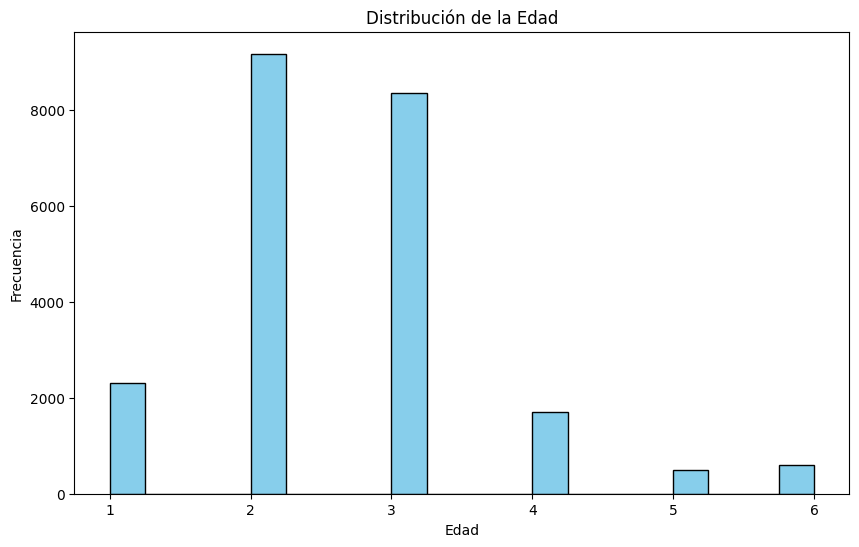

In [84]:
# dsi, cuentapropia

import seaborn as sns
import matplotlib.pyplot as plt

# Crear el gráfico de densidad
plt.figure(figsize=(10,6))

# Crear el histograma
plt.hist(dataset_v5['estrato1'], bins=20, color='skyblue', edgecolor='black')

# Añadir títulos y etiquetas
plt.title('Distribución de la Edad')
plt.xlabel('Edad')
plt.ylabel('Frecuencia')

# Mostrar el gráfico
plt.show()

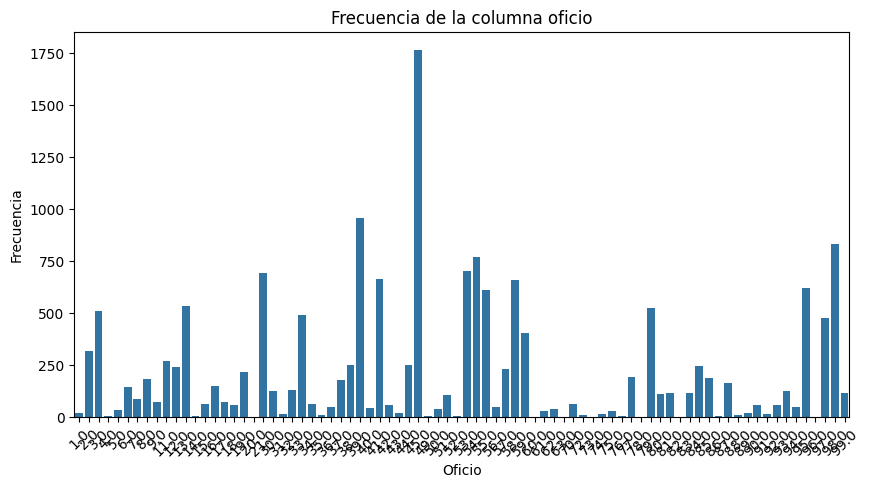

In [84]:
plt.figure(figsize=(10, 5))

# Graficar la frecuencia de la columna 'oficio'
sns.countplot(x='oficio', data=dataset_v4)

# Añadir título y etiquetas a los ejes
plt.title('Frecuencia de la columna oficio')
plt.xlabel('Oficio')
plt.ylabel('Frecuencia')

# Rotar las etiquetas del eje x si es necesario
plt.xticks(rotation=45)

plt.savefig('high_cardinality.png', format='png', dpi=300, bbox_inches='tight')
# Mostrar el gráfico
plt.show()

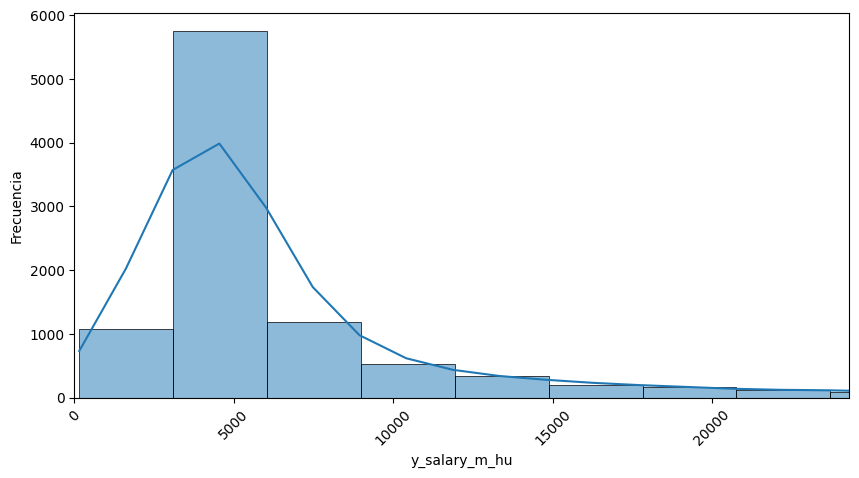

In [89]:
plt.figure(figsize=(10, 5))

# Graficar la frecuencia de la columna 'oficio'
sns.histplot(x='y_salary_m_hu', data=dataset_v5, bins=int(np.sqrt(len(dataset_v5))), kde=True)

# Añadir título y etiquetas a los ejes
plt.title('')
plt.xlabel('y_salary_m_hu')
plt.ylabel('Frecuencia')
plt.xlim(0, dataset_v5['y_salary_m_hu'].quantile(0.95))

# Rotar las etiquetas del eje x si es necesario
plt.xticks(rotation=45)

plt.savefig('target_variable.png', format='png', dpi=300, bbox_inches='tight')
# Mostrar el gráfico
plt.show()